# Auswertung Genauigkeit Gesichtserkennung

Da unsere Daten aus dem Internet gescraped sind, sind sie nicht gelabelt, was eine herkömmliche Validierung schwierig macht. Deswegen haben wir mehrere Herangehensweisen identifiziert, von denen wir einige ausprobieren werden:

1. Face Count:
    - Wir erstellen einen kleineren Stichproben-Datensatz von random Bildern aus unseren gescrapten Bildern.
    - Diesen Datensatz labeln wir per Hand mit der Anzahl von Gesichtern pro Bild.
    - Dann wenden wir unser Modell auf den Datensatz an und vergleichen die Anzahl erkannter Gesichter pro Bild vs. die tatsächliche Anzahl.
    - Mögliche Metriken: Mean Absolute Error (MAE) oder Root Mean Square Error (RMSE).
    - Problem: Es wird kein qualitativer Vergleich gemacht -> Das Model könnte 4 falsche Gesichter erkennen auf einem Bild mit 4 tatsächlichen Gesichtern und hätte eine Genauigkeit von 100%.
2. Bounding Box
    - Wir erstellen einen kleinen Datensatz von random Bildern aus den gescrapten Bildern.
    - Dann zeichnen wir per Hand eine Bounding Box um die Gesichter.
    - Wir wenden das Modell auf die Bilder an und vergleichen die handgezeichnete Bounding Box mit der vom Modell gezeichneten.
    - Mögliche Metriken: Intersection over Union (IoU)
    - Problem: Es ist sehr aufwändig, die Bounding Boxes per Hand zu zeichnen, weswegen wir nur wenige Bildern analysieren könnten.
3. Pre-Labeled Dataset
    - Wir suchen einen bereits gelabelten Datensatz aus dem Internet und wenden unser Modell darauf an.
    - Dann werten wir die Ergebnisse aus und vergleichen diese mit den Labels.
    - Problem: Die Performance des Modells auf dem Pre-labeled Datensatz ist nur eingeschränkt übertragbar auf die Genauigkeit bei unseren Bildern. Außerdem wurde die Performance des Modells auf anderen Datensätzen schon ausführlich von anderen untersucht und bringt unserer Meinung nach keinen Mehrwert für unser Projekt.


In [9]:
from PIL import Image
from shapely.geometry import Polygon
from shapely.ops import unary_union
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score
from sklearn.metrics import mean_absolute_error, mean_squared_error
import matplotlib.pyplot as plt
import pandas as pd
from mtcnn.mtcnn import MTCNN
import os
import numpy as np
import cv2
import matplotlib.patches as patches

## 1. Face-Count

In [10]:
def display_random_images(dataframe, sample_size=20):
    # Select random images
    random_sample = dataframe.sample(n=sample_size, random_state=42)

    selected_rows = []
    for index, row in random_sample.iterrows():
        img_path = os.path.join("./scraper/images/", row['name'])
        img = Image.open(img_path)

        # Display the image
        plt.imshow(img)
        plt.title(f"Region: {row['region']} | Year: {row['year']}")
        plt.axis('off')
        plt.show()

        selected_rows.append(row)

    return selected_rows

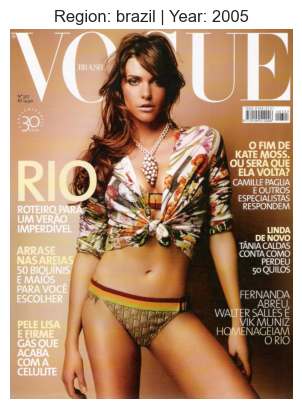

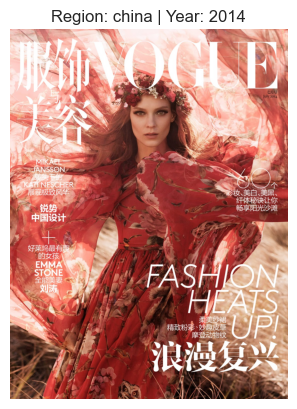

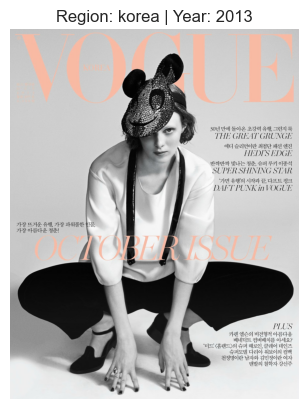

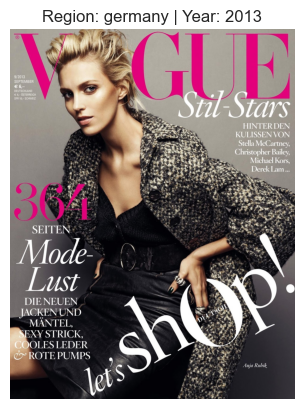

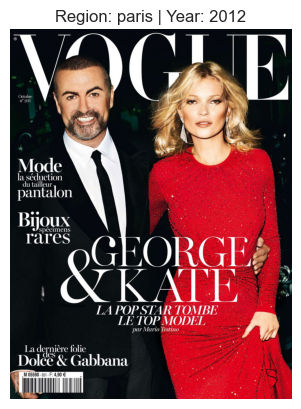

...

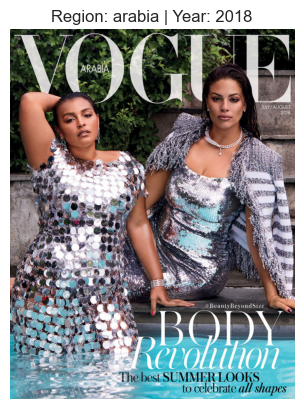

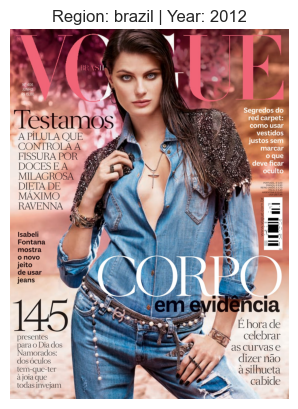

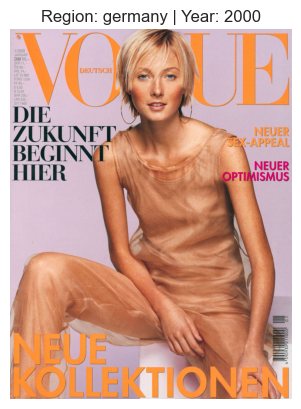

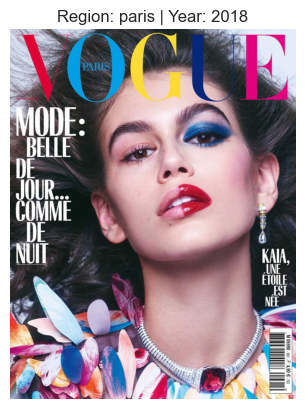

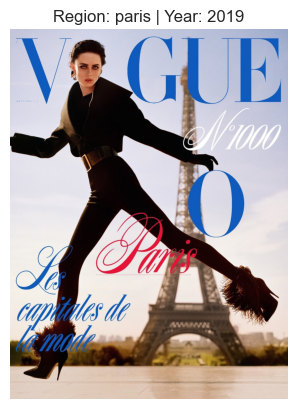

In [11]:
df = pd.read_csv('./scraper/updated_file.csv')
random_images = display_random_images(df, sample_size=50)

In [12]:
# händisch Gesichter zählen und dann Länge der Liste überprüfen
face_counts = [1, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 3, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1]
print(len(face_counts))
print(len(random_images))

50
50


In [13]:
def add_face_count(selected_rows, face_counts):
    for i, face_count in enumerate(face_counts):
        selected_rows[i]['face_count'] = face_count
    return selected_rows

In [14]:
# Liste auf dataframe mappen als neue Spalte
updated_random_images = add_face_count(random_images, face_counts)

In [15]:
# detect_faces-Methode so abändern, dass sie in zusätzlicher Spalte die Anzahl der erkannten Gesichter speichert
def detect_faces(df):
    stop_num = 0
    
    detector = MTCNN()
    countries = {}  # dictionary
    face_list = []
    
    for filename in df['name'].unique():
        stop_num += 1

        if filename.lower().endswith(('.jpg', '.jpeg', '.png')):
            image_path = os.path.join('./scraper/images/', filename)
            image = cv2.imread(image_path)
            image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

            country, number = filename.split("_")
            number = int(number.split(".")[0])
    
            if country not in countries:
                countries[country] = 1
            else:
                countries[country] += 1

            # get info of csv as well
            row = df[df['name'] == filename]
            year = row['year'].values[0]

            image_info = {
                'filename': filename,
                'country': country,
                'number': number,
                'image': image,
                'year': year
            }

            try:
                faces = detector.detect_faces(image)
                num_faces = len(faces)
                df.loc[df['name'] == filename, 'num_faces_detected'] = num_faces
                
                if not faces:
                    print(f"No faces detected in {filename}")
                else:
                    for i, face in enumerate(faces):
                        x, y, width, height = face['box']
                        face_image = image[y:y+height, x:x+width]
                        face_info = {
                            'filename': image_info['filename'],
                            'country': image_info['country'],
                            'number': image_info['number'],
                            'year': image_info['year'],
                            'face_number': i + 1,  # face number in the current image
                            'face_image': face_image
                        }
                        face_list.append(face_info)
                        print(f"Number appended: {stop_num}")
            except Exception as e:
                print(f"Error processing {filename}: {str(e)}")
    
    return df, face_list, countries

In [16]:
df = pd.DataFrame(updated_random_images, columns=['name', 'region', 'url', 'year', 'face_count'])
final_random_images, face_list, countries = detect_faces(df)

2/2 [==============================] - 0s 4ms/step
Number appended: 1
2/2 [==============================] - 0s 5ms/step
Number appended: 2
1/1 [==============================] - 0s 14ms/step
No faces detected in korea_90.jpg
1/1 [==============================] - 0s 16ms/step
Number appended: 4
Number appended: 4
1/1 [==============================] - 0s 16ms/step
Number appended: 5
Number appended: 5
Number appended: 5
1/1 [==============================] - 0s 14ms/step
Number appended: 6
1/1 [==============================] - 0s 13ms/step
Number appended: 7
1/1 [==============================] - 0s 15ms/step
Number appended: 8
1/1 [==============================] - 0s 14ms/step
Number appended: 9
1/1 [==============================] - 0s 14ms/step
Number appended: 10
1/1 [==============================] - 0s 12ms/step
Number appended: 11
1/1 [==============================] - 0s 13ms/step
Number appended: 12
1/1 [==============================] - 0s 16ms/step
Number appended: 13
1/1

#### Auswertung der Ergebnisse

_Accuracy, Precision, Recall, F1-Score_

In [17]:
df.dropna(subset=['face_count', 'num_faces_detected'], inplace=True)
df['face_count'] = df['face_count'].astype(int)
df['num_faces_detected'] = df['num_faces_detected'].astype(int)

y_true = df['face_count']
y_pred = df['num_faces_detected']

# Metriken berechnen
accuracy = accuracy_score(y_true, y_pred)
precision = precision_score(y_true, y_pred, average='weighted')
recall = recall_score(y_true, y_pred, average='weighted')
f1 = f1_score(y_true, y_pred, average='weighted')

print(f"Accuracy: {accuracy}")
print(f"Precision: {precision}")
print(f"Recall: {recall}")
print(f"F1 Score: {f1}")

Accuracy: 0.82
Precision: 0.9466666666666668
Recall: 0.82
F1 Score: 0.874367816091954


C:\Users\susan\Documents\GitHub\ki-big-data\venv\lib\site-packages\sklearn\metrics\_classification.py:1471: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Alle Werte deuten auf eine gute Leistung des Modells hin, wobei natürlich beachtet werden muss, dass wir nicht auswerten können, ob die korrekten Gesichter in jedem Bild erkannt wurden.

_MAE und RMSE_

Wir wollen nachschauen, wie stark die Abweichungen der detektierten Gesichter von den tatsächlichen sind.

In [18]:
# MAE und RMSE berechnen
mae = mean_absolute_error(df['face_count'], df['num_faces_detected'])
rmse = mean_squared_error(df['face_count'], df['num_faces_detected'], squared=False)

print(f"Mean Absolute Error (MAE): {mae}")
print(f"Root Mean Square Error (RMSE): {rmse}")

Mean Absolute Error (MAE): 0.18
Root Mean Square Error (RMSE): 0.4242640687119285


Der recht kleine MAE ist zufriedenstellend, wobei aber der höhere RMSE darauf hinweist, dass es einige große Ausreißer geben kann.

_Residuals_

Gibt es eine Richtung bei den Abweichungen?

Number of Overestimations: 7
Number of Underestimations: 2
Number of Correct Predictions: 41


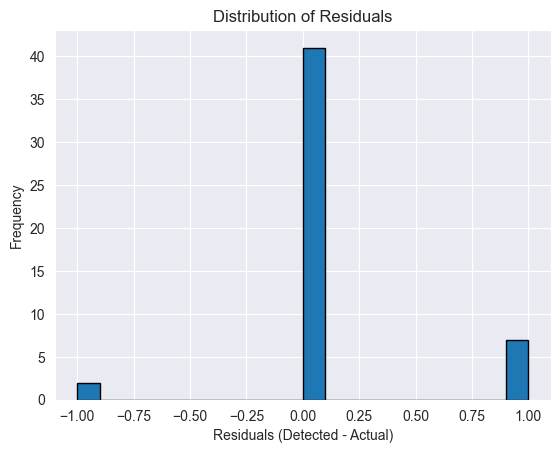

In [19]:
# Differenzen berechnen
df['residuals'] = df['num_faces_detected'] - df['face_count']

overestimations = df[df['residuals'] > 0]
underestimations = df[df['residuals'] < 0]
correct_predictions = df[df['residuals'] == 0]

print(f"Number of Overestimations: {len(overestimations)}")
print(f"Number of Underestimations: {len(underestimations)}")
print(f"Number of Correct Predictions: {len(correct_predictions)}")

plt.hist(df['residuals'], bins=20, edgecolor='black')
plt.title('Distribution of Residuals')
plt.xlabel('Residuals (Detected - Actual)')
plt.ylabel('Frequency')
plt.show()

Der Plot der Residuals deutet darauf hin, dass unser Modell eher zu viele Gesichter erkennt als zu wenige, wobei jedoch aufgrund der kleinen Sample-Size hier keine eindeutige Aussage getroffen werden kann.

### 2. Bounding Box

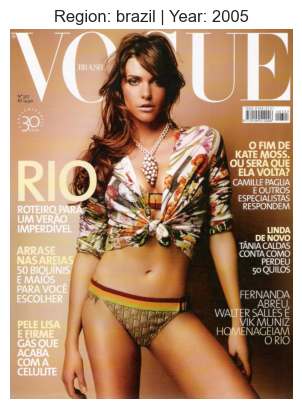

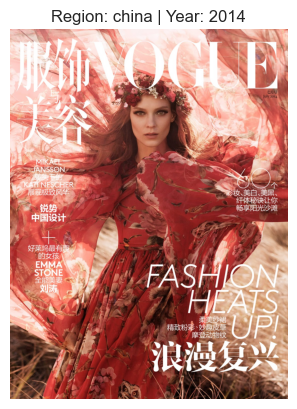

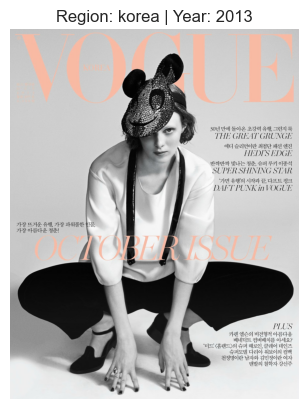

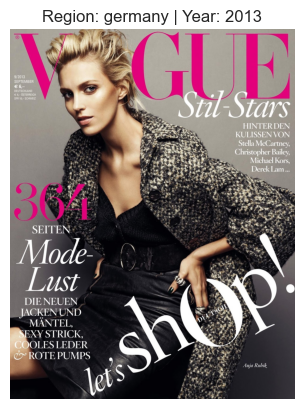

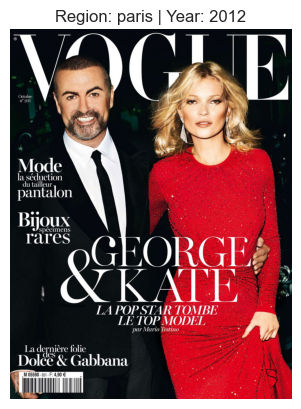

...

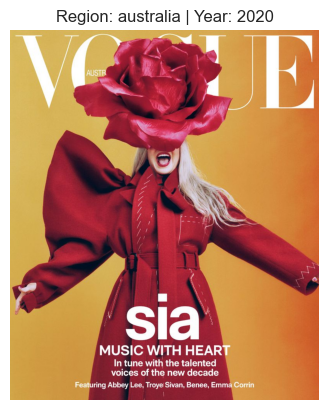

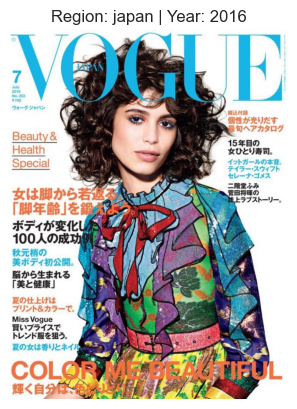

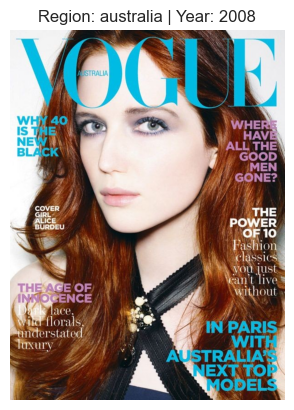

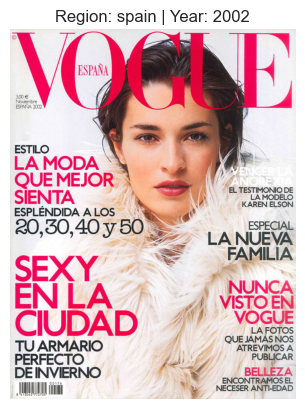

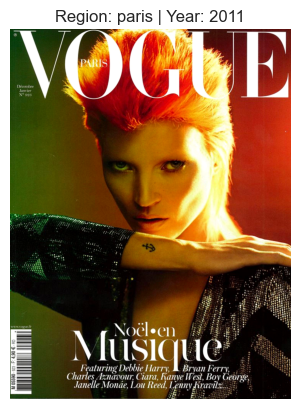

In [20]:
# Diesmal nutzen wir einen noch kleineren Sample-Datensatz, weil das händische Bestimmen der Bounding-Boxes sehr zeitintensiv ist
df = pd.read_csv('./scraper/updated_file.csv')
random_images = display_random_images(df, sample_size=20)

In [21]:
# Bilder mit Grid und Achsen plotten, um das Ausmessen der Boxes zu erleichtern
def display_images_with_grid(df):
    for index, row in df.iterrows():
        image_path = f"./scraper/images/{row['name']}"  # Update the path accordingly
        img = cv2.imread(image_path)
        img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

        # Create a grid
        grid_size = 50
        h, w, _ = img.shape
        x_ticks = np.arange(0, w, grid_size)
        y_ticks = np.arange(0, h, grid_size)

        # Display the image with grid
        plt.figure(figsize=(10, 10))
        plt.imshow(img_rgb)
        plt.xticks(x_ticks)
        plt.yticks(y_ticks)
        plt.grid(True, color='white')

        # Set axis limits
        plt.xlim(0, w)
        plt.ylim(h, 0)

        plt.title(f"Image: {row['name']}")

        # Show the image
        plt.show()

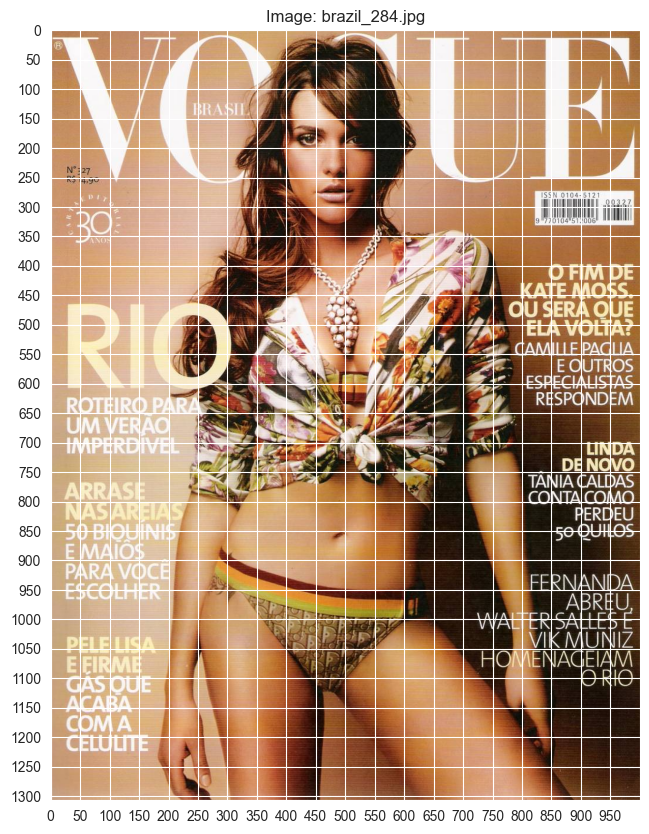

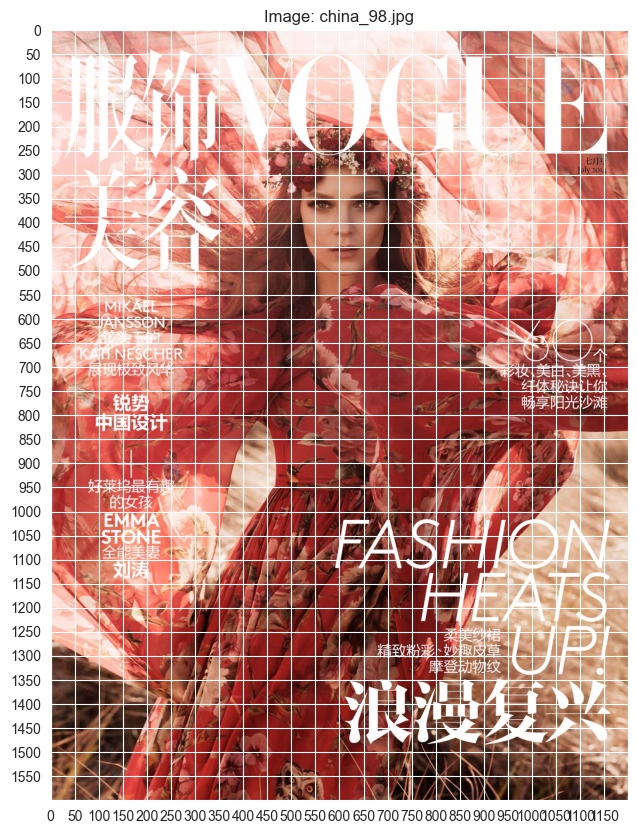

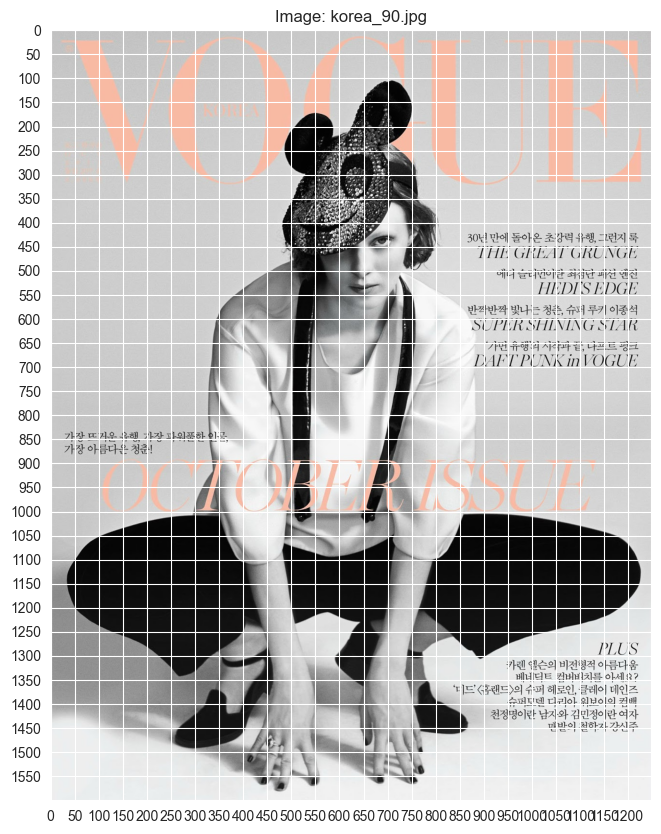

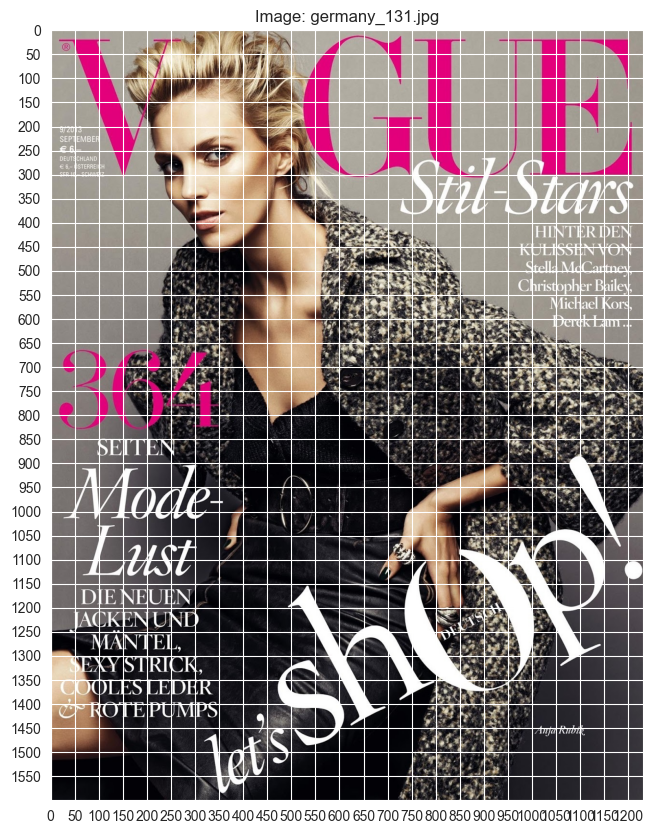

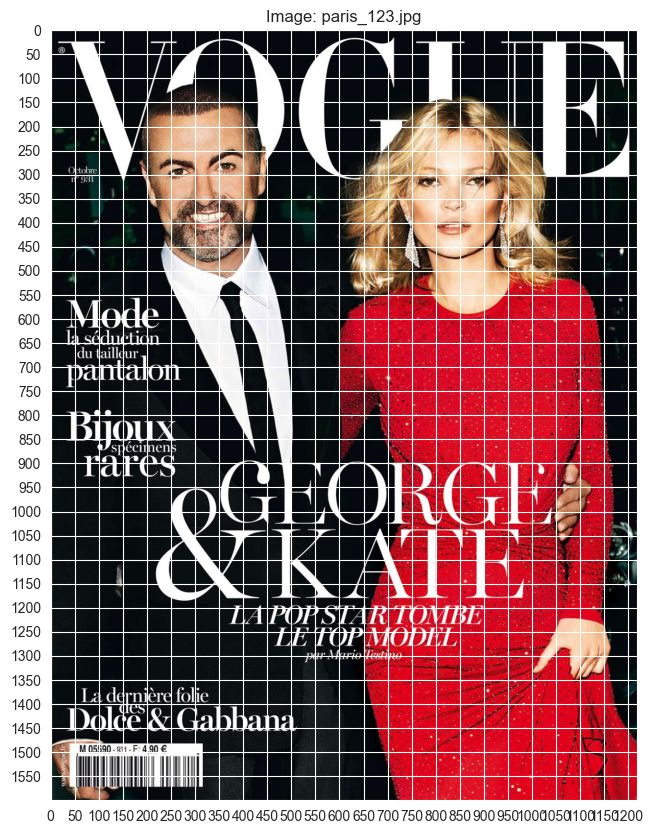

...

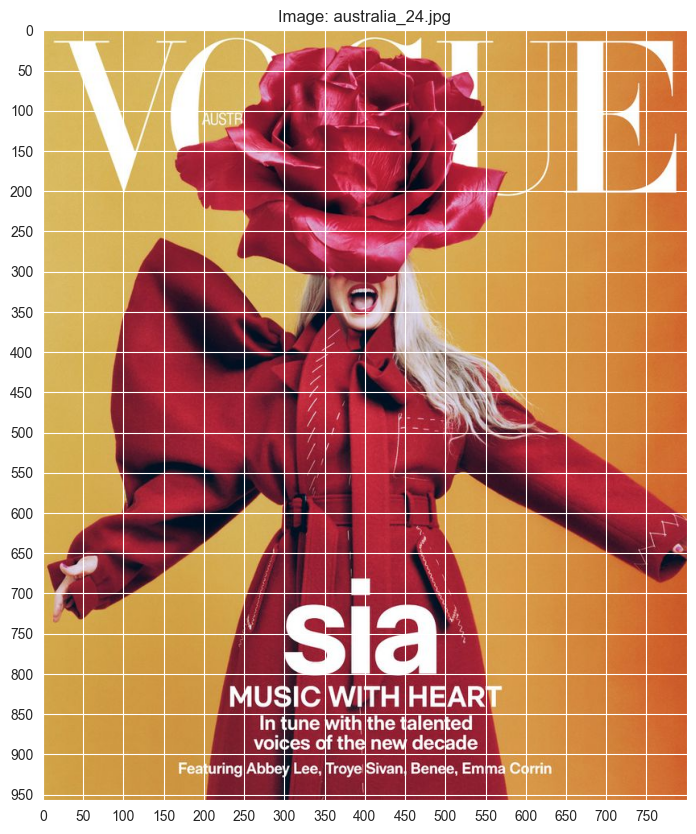

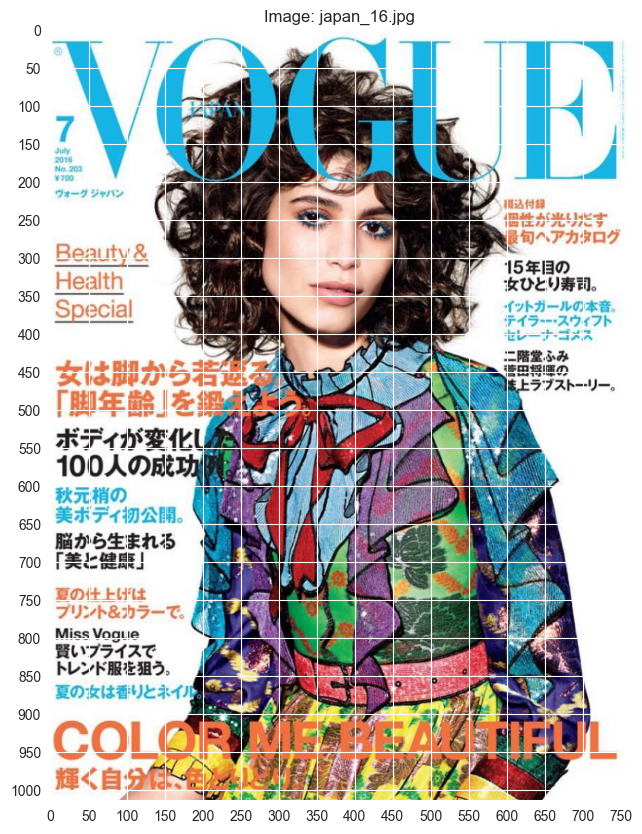

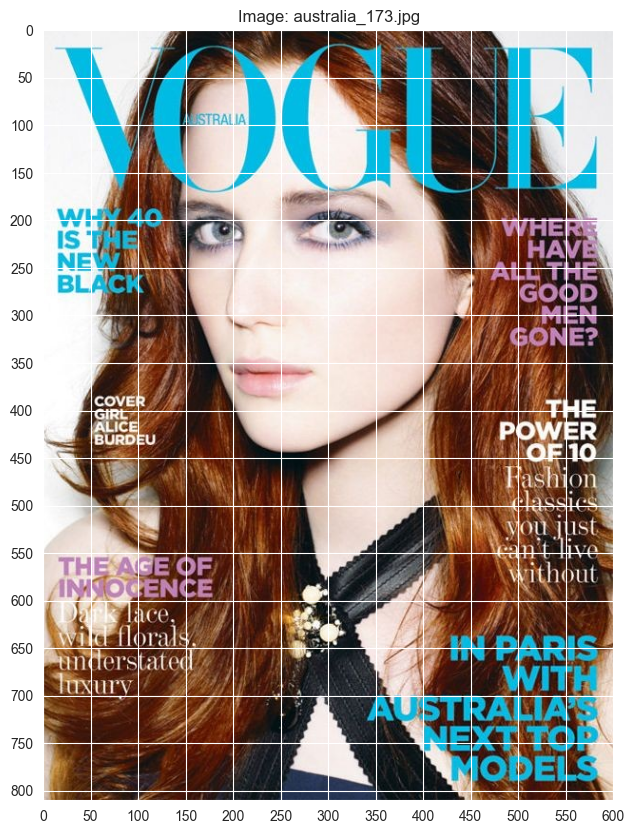

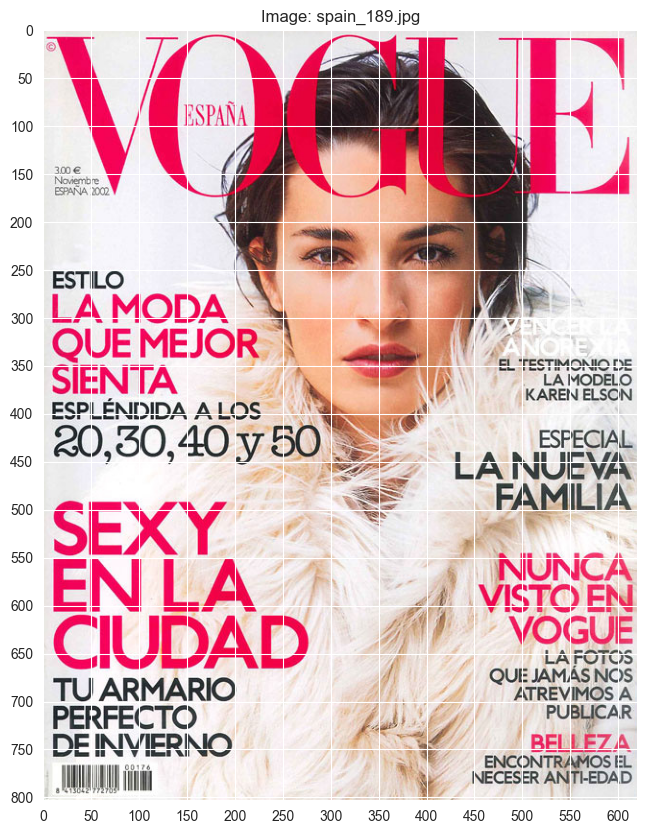

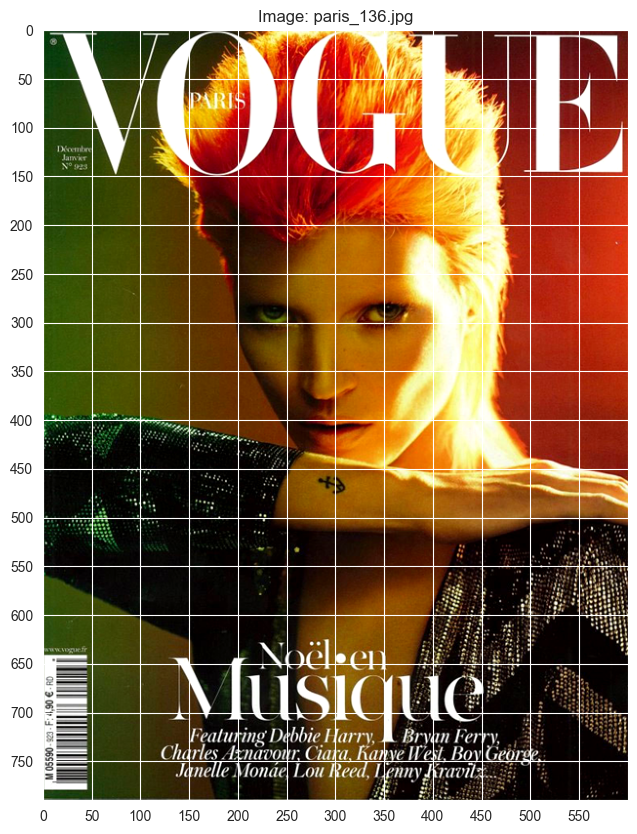

In [22]:
df = pd.DataFrame(random_images, columns=['name', 'region', 'url', 'year'])
display_images_with_grid(df)

In [23]:
# Händisch die Bounding Boxes bestimmen nach Schema: Koordinaten der oberen linken Ecke (x, y), Breite und Höhe
boxes = [[(400, 100, 150, 250)],
         [(500, 250, 200, 250)],
         [(550, 350, 200, 250)],
         [(200, 150, 250, 300)],
         [(200, 150, 250, 350), (750, 200, 200, 300)],
         [(250, 50, 150, 250)],
         [(400, 350, 50, 100)],
         [(350, 50, 100, 150)],
         [(150, 100, 500, 650)],
         [(100, 50, 800, 1200)],
         [(300, 100, 400, 450)],
         [(450, 50, 100, 150)],
         [(300, 250, 600, 800)],
         [(450, 150, 100, 100)],
         [(600, 300, 200, 200)],
         [(350, 300, 100, 100)],
         [(300, 150, 150, 250)],
         [(150, 50, 250, 400)],
         [(250, 100, 200, 300)],
         [(200, 200, 200, 250)]]

print(len(boxes))

20


In [24]:
# Als neue Spalte in Dataframe einfügen
df['boxes_list'] = boxes

In [25]:
# detect_faces-Methode so anpassen, dass eine Liste der Bounding Boxes der erkannten Gesichter im gleichen Format erstellt wird
def detect_faces(df):
    stop_num = 0
    
    detector = MTCNN()
    countries = {}  # dictionary
    face_list = []
    
    boxes_column = []
    for filename in df['name'].unique():
        stop_num += 1

        if filename.lower().endswith(('.jpg', '.jpeg', '.png')):
            image_path = os.path.join('./scraper/images/', filename)
            image = cv2.imread(image_path)
            image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

            country, number = filename.split("_")
            number = int(number.split(".")[0])
    
            if country not in countries:
                countries[country] = 1
            else:
                countries[country] += 1

            # get info of csv as well
            row = df[df['name'] == filename]
            year = row['year'].values[0]

            image_info = {
                'filename': filename,
                'country': country,
                'number': number,
                'image': image,
                'year': year
            }

            try:
                faces = detector.detect_faces(image)
                num_faces = len(faces)
                df.loc[df['name'] == filename, 'num_faces_detected'] = num_faces
                detected_bounding_boxes = []
                
                if not faces:
                    print(f"No faces detected in {filename}")
                    boxes_column.append([])
                else:
                    for i, face in enumerate(faces):
                        x, y, width, height = face['box']
                        print(face['box'])
                        face_image = image[y:y+height, x:x+width]
                        face_info = {
                            'filename': image_info['filename'],
                            'country': image_info['country'],
                            'number': image_info['number'],
                            'year': image_info['year'],
                            'face_number': i + 1,  # face number in the current image
                            'face_image': face_image
                        }
                        face_list.append(face_info)
                        
                        # Append the bounding box to the list
                        detected_bounding_boxes.append((x, y, width, height))
                        
                        print(f"Number appended: {stop_num}")
                    boxes_column.append(detected_bounding_boxes)
            except Exception as e:
                print(f"Error processing {filename}: {str(e)}")
    
    return df, face_list, countries, boxes_column

In [26]:
df, face_list, countries, boxes_column = detect_faces(df)
# Länge der neuen Spalte überprüfen
print(len(boxes_column))

2/2 [==============================] - 0s 4ms/step
[385, 96, 165, 232]
Number appended: 1
2/2 [==============================] - 0s 4ms/step
[513, 278, 183, 235]
Number appended: 2
1/1 [==============================] - 0s 12ms/step
No faces detected in korea_90.jpg
1/1 [==============================] - 0s 16ms/step
[205, 134, 258, 321]
Number appended: 4
[166, 662, 52, 59]
Number appended: 4
1/1 [==============================] - 0s 16ms/step
[213, 171, 203, 295]
Number appended: 5
[734, 213, 196, 253]
Number appended: 5
[1121, 1112, 19, 24]
Number appended: 5
1/1 [==============================] - 0s 15ms/step
[245, 73, 147, 211]
Number appended: 6
1/1 [==============================] - 0s 14ms/step
[405, 388, 45, 59]
Number appended: 7
1/1 [==============================] - 0s 14ms/step
[361, 60, 98, 152]
Number appended: 8
1/1 [==============================] - 0s 14ms/step
[156, 168, 417, 547]
Number appended: 9
1/1 [==============================] - 0s 15ms/step
[66, 57, 869, 12

In [27]:
print(boxes_column)

[[(385, 96, 165, 232)], [(513, 278, 183, 235)], [], [(205, 134, 258, 321), (166, 662, 52, 59)], [(213, 171, 203, 295), (734, 213, 196, 253), (1121, 1112, 19, 24)], [(245, 73, 147, 211)], [(405, 388, 45, 59)], [(361, 60, 98, 152)], [(156, 168, 417, 547)], [(66, 57, 869, 1227)], [(319, 79, 366, 478)], [(448, 71, 99, 139)], [(251, 217, 644, 847)], [(464, 140, 81, 114)], [(598, 239, 220, 282)], [], [(275, 154, 186, 239), (179, 134, 38, 49)], [(123, 61, 311, 372)], [(237, 117, 211, 295)], [(182, 171, 223, 298)]]


In [28]:
# Spalte in Dataframe hinzufügen
df['detected_bounding_boxes'] = boxes_column

In [29]:
df.head()

,name,region,url,year,boxes_list,num_faces_detected,detected_bounding_boxes
599,brazil_284.jpg,brazil,https://2.bp.blogspot.com/-phw42ZpxCSs/V_0aXoe...,2005,"[(400, 100, 150, 250)]",1.0,"[(385, 96, 165, 232)]"
752,china_98.jpg,china,http://2.bp.blogspot.com/-i9MqFVmsQ1o/Vh-E5Qz_...,2014,"[(500, 250, 200, 250)]",1.0,"[(513, 278, 183, 235)]"
2016,korea_90.jpg,korea,https://4.bp.blogspot.com/-z1aEsouLGK8/V4pMNCi...,2013,"[(550, 350, 200, 250)]",0.0,[]
1001,germany_131.jpg,germany,http://1.bp.blogspot.com/-PCbAuOMsoHw/VeSLiXRM...,2013,"[(200, 150, 250, 300)]",2.0,"[(205, 134, 258, 321), (166, 662, 52, 59)]"
2514,paris_123.jpg,paris,http://1.bp.blogspot.com/-U2bJJ-wzGxE/Vdx1TTTQ...,2012,"[(200, 150, 250, 350), (750, 200, 200, 300)]",3.0,"[(213, 171, 203, 295), (734, 213, 196, 253), (..."


_Plot Bounding Boxes_

In [30]:
# Methode zum Zeichnen der Bounding Boxes, Grün für die händisch erstellten und rot für die vom Model erstellten
def plot_boxes(image, actual_boxes, detected_boxes):
    fig, ax = plt.subplots(1)
    ax.imshow(image)

    for box in actual_boxes:
        rect = patches.Rectangle((box[0], box[1]), box[2], box[3], linewidth=2, edgecolor='g', facecolor='none')
        ax.add_patch(rect)

    for box in detected_boxes:
        rect = patches.Rectangle((box[0], box[1]), box[2], box[3], linewidth=2, edgecolor='r', facecolor='none')
        ax.add_patch(rect)

    plt.show()

In [31]:
# Methode zum Zeichnen der Intersection over Union-Metrik
def calculate_iou(box1, box2):
    poly1 = Polygon([(box1[0], box1[1]), (box1[0] + box1[2], box1[1]),
                     (box1[0] + box1[2], box1[1] + box1[3]), (box1[0], box1[1] + box1[3])])

    poly2 = Polygon([(box2[0], box2[1]), (box2[0] + box2[2], box2[1]),
                     (box2[0] + box2[2], box2[1] + box2[3]), (box2[0], box2[1] + box2[3])])

    intersection = poly1.intersection(poly2).area
    union = unary_union([poly1, poly2]).area

    iou = intersection / union if union > 0 else 0.0
    return iou

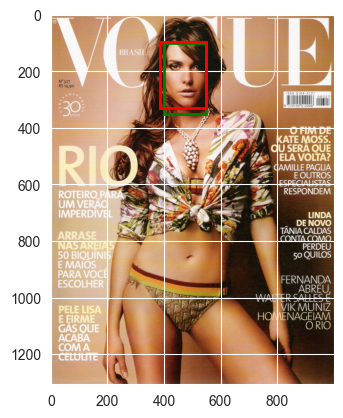

IoU for actual_box (400, 100, 150, 250) and detected_box (385, 96, 165, 232): 0.8225108225108225


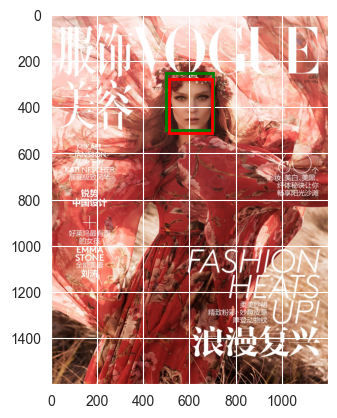

IoU for actual_box (500, 250, 200, 250) and detected_box (513, 278, 183, 235): 0.7756161820576949


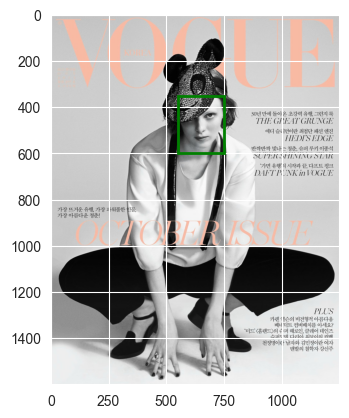

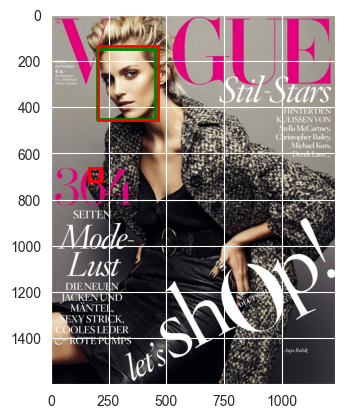

IoU for actual_box (200, 150, 250, 300) and detected_box (205, 134, 258, 321): 0.8716999928840817
IoU for actual_box (200, 150, 250, 300) and detected_box (166, 662, 52, 59): 0.0


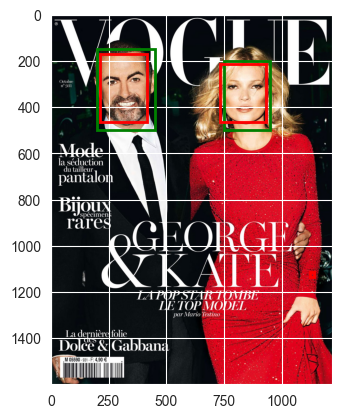

IoU for actual_box (200, 150, 250, 350) and detected_box (213, 171, 203, 295): 0.6844
IoU for actual_box (200, 150, 250, 350) and detected_box (734, 213, 196, 253): 0.0
IoU for actual_box (200, 150, 250, 350) and detected_box (1121, 1112, 19, 24): 0.0
IoU for actual_box (750, 200, 200, 300) and detected_box (213, 171, 203, 295): 0.0
IoU for actual_box (750, 200, 200, 300) and detected_box (734, 213, 196, 253): 0.7110292280789408
IoU for actual_box (750, 200, 200, 300) and detected_box (1121, 1112, 19, 24): 0.0


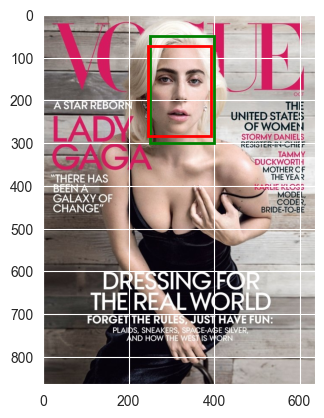

IoU for actual_box (250, 50, 150, 250) and detected_box (245, 73, 147, 211): 0.7771235896770847


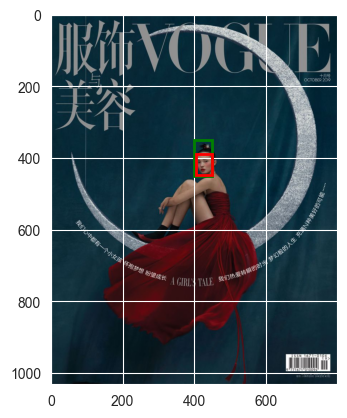

IoU for actual_box (400, 350, 50, 100) and detected_box (405, 388, 45, 59): 0.531


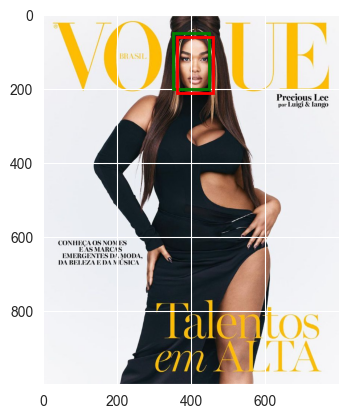

IoU for actual_box (350, 50, 100, 150) and detected_box (361, 60, 98, 152): 0.7146134434503326


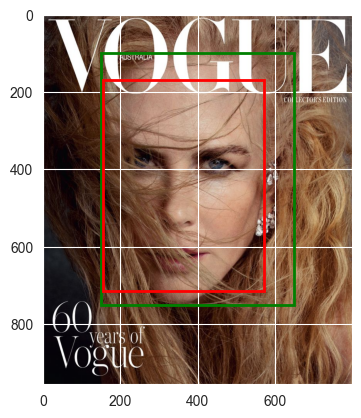

IoU for actual_box (150, 100, 500, 650) and detected_box (156, 168, 417, 547): 0.7018430769230769


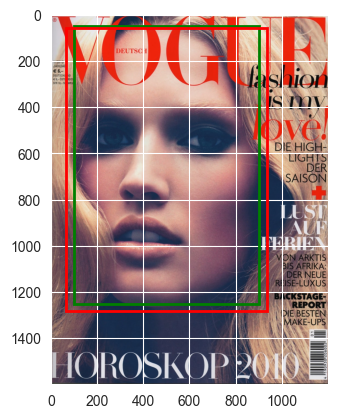

IoU for actual_box (100, 50, 800, 1200) and detected_box (66, 57, 869, 1227): 0.8904123008257585


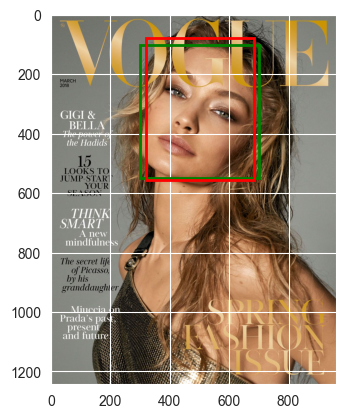

IoU for actual_box (300, 100, 400, 450) and detected_box (319, 79, 366, 478): 0.865712123123502


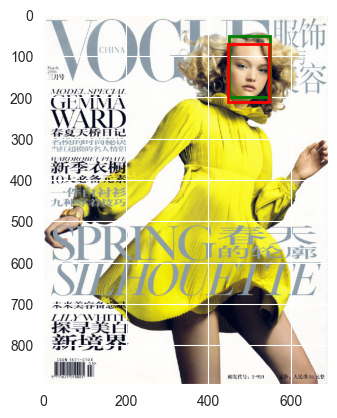

IoU for actual_box (450, 50, 100, 150) and detected_box (448, 71, 99, 139): 0.7701255539143279


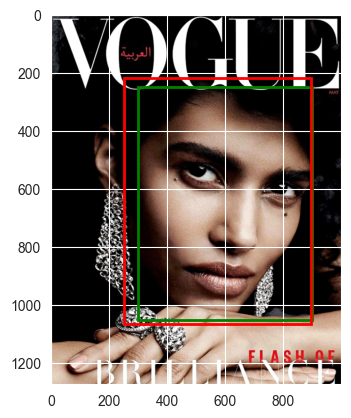

IoU for actual_box (300, 250, 600, 800) and detected_box (251, 217, 644, 847): 0.8662924865506272


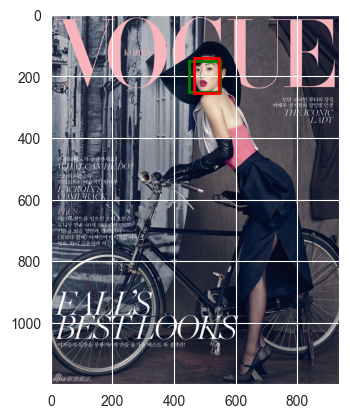

IoU for actual_box (450, 150, 100, 100) and detected_box (464, 140, 81, 114): 0.727501347224717


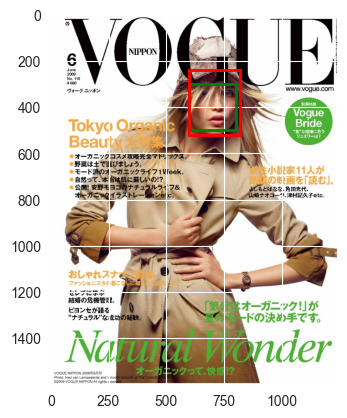

IoU for actual_box (600, 300, 200, 200) and detected_box (598, 239, 220, 282): 0.6447453255963894


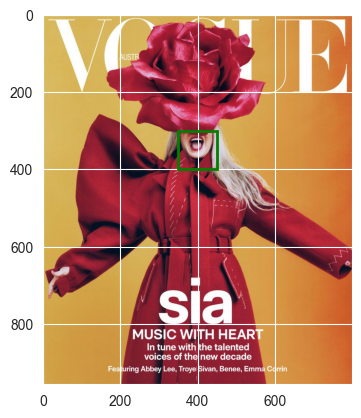

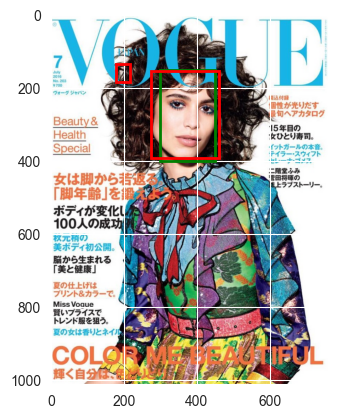

IoU for actual_box (300, 150, 150, 250) and detected_box (275, 154, 186, 239): 0.7775897969807392
IoU for actual_box (300, 150, 150, 250) and detected_box (179, 134, 38, 49): 0.0


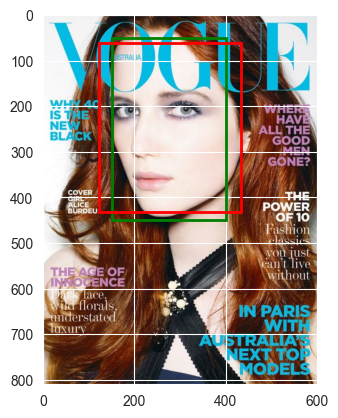

IoU for actual_box (150, 50, 250, 400) and detected_box (123, 61, 311, 372): 0.7579956313370065


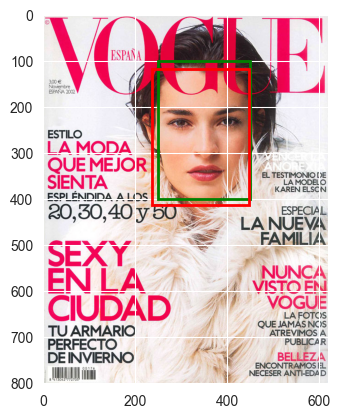

IoU for actual_box (250, 100, 200, 300) and detected_box (237, 117, 211, 295): 0.8462944223769464


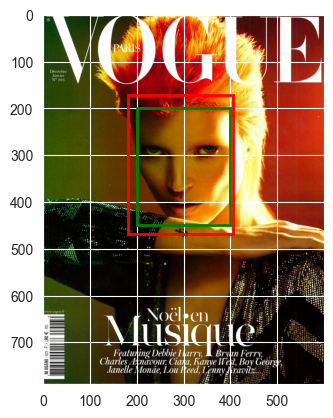

IoU for actual_box (200, 200, 200, 250) and detected_box (182, 171, 223, 298): 0.7524001564992325


In [32]:
# Boxes plotten und dazu IoU berechnen
for index, row in df.iterrows():
    image_path = f"./scraper/images/{row['name']}"
    img = cv2.imread(image_path)
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    
    actual_boxes = row['boxes_list']
    detected_boxes = row['detected_bounding_boxes']
    
    plot_boxes(img_rgb, actual_boxes, detected_boxes)
    
    for actual_box in actual_boxes:
        
        for detected_box in detected_boxes:
            iou = calculate_iou(actual_box, detected_box)
            
            print(f"IoU for actual_box {actual_box} and detected_box {detected_box}: {iou}")

Wir können anhand der Plots erkennen, dass das Model sehr ähnliche Boxen zu der händischen Analyse zeichnet. Außerdem sehen wir durch die Berechnung der Intersection over Union-Metrik, dass der Overlap sehr groß ist, wenn das gleiche Gesicht erkannt wird. Wir können sehen, dass das Model die größten Schwierigkeiten hat, wenn viel von dem Gesicht verdeckt ist. Für eine ausführlichere Analyse wäre aber auch hier ein größerer Datensatz notwendig, was das zeitintensive Labeln per Hand verlangt. Eine andere Möglichkeit könnte hier auch sein, ein zweites Modell zur Hilfe zu ziehen oder eine Online-face-Detection-API und deren Ergebnisse zum Vergleich heranzuziehen.